## Thetas
This notebook takes an AsGARD datastore, and calculates per-population diversity statistics (theta, pi and Tajima's D).

Tristan Dennis, 2024.

In [1]:
#Import libs

import sgkit as sg
import allel
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
import glob
from sklearn.mixture import GaussianMixture
from sklearn.utils.extmath import row_norms

In [10]:
#define some useful dicts

#px config
config = {
  'toImageButtonOptions': {
    'format': 'png', # one of png, svg, jpeg, webp
    'filename': 'custom_image',
    'height': 500,
    'width': 700,
    'scale':6 # Multiply title/legend/axis/canvas sizes by this factor
  }
}

#palette for plotting
countrycols = {
'Afghanistan' : '#a6cee3',
'Pakistan' : '#1f78b4',
'India' : '#b2df8a',
'SaudiArabia' : '#33a02c',
'Ethiopia': '#fb9a99',
'Djibouti' : '#e31a1c',
'Sudan' : '#fdbf6f',
'Yemen' : '#ff7f00'}

analysis_popcols =  {'saudi_e': '#6a3d9a',
'saudi_r': '#cab2d6',
'india_m': '#a6cee3',
 'india_b': '#1f78b4',
 'afgh_pak': '#ff7f00',
 'djibouti': '#e31a1c',
 'ethiopia_n': '#33a02c',
 'ethiopia_so': '#b2df8a',
 'yemen': '#fdbf6f',
 'sudan': '#fb9a99'}

In [ ]:
#load data
ds = sg.load_dataset('/Users/dennistpw/Projects/AsGARD/data/variants_combined_cohorts/combined_cohorts.CM023248.zarr')

#load and filter metadata
df_samples = pd.read_csv('/Users/dennistpw/Projects/AsGARD/metadata/cease_combinedmetadata_qcpass.20240914.csv')

#define results dir
outdir = '/Users/dennistpw/Projects/AsGARD/data/results_cache'

In [6]:
#Get dictionary of population/sample indices for calculating per-pop allele counts
# Initialize an empty dictionary to store row indices for each level
pop_dict = {}

# Iterate through unique levels in the 'factor_column'
for level in df_samples['analysis_pop'].unique():
    # Get the row indices where the 'factor_column' matches the current level
    indices = df_samples.index[df_samples['analysis_pop'] == level].tolist()
    
    # Store the indices in the dictionary with the level as the key
    pop_dict[level] = indices

# Remove dictionary entries with fewer than 5 values
pop_dict = {key: value for key, value in pop_dict.items() if len(value) >= 5}

# Print the updated dictionary
print(pop_dict)


{'afgh_pak': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 224, 225, 226, 227, 228, 371, 372, 373, 374, 375, 376, 377, 413, 414, 415, 416, 417], 'ethiopia_n': [25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 310, 311, 312, 313, 314, 315, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354], 'sudan': [44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152,

In [8]:
# get accessible GTs

# extract gts
gt = allel.GenotypeArray(ds.call_genotype)
# get acc mask
accmask = ds['is_accessible'].compute()
#filter
gt = gt.compress(accmask)

#get array of accessible pos
pos = ds.variant_position.values
pos = pos.compress(accmask)

#Now calculate pop-specific allele counts
ac_subpop = gt.count_alleles_subpops(pop_dict)

In [11]:
#infer watterson's theta
thetlist = []
for pop in pop_dict.keys():
    ac = ac_subpop.get(pop)
    th = allel.watterson_theta(pos, ac, start=1, stop=93706023)
    thetlist.append(th)

In [12]:
#infer pi
tajdf = pd.DataFrame()
for pop in pop_dict.keys():
    ac = ac_subpop.get(pop)
    td = allel.windowed_tajima_d(pos, ac, size=10000, start=1, stop=93706023)
    tajdf[pop] = td[0]

In [13]:
#infer pi
pidf = pd.DataFrame()
for pop in pop_dict.keys():
    ac = ac_subpop.get(pop)
    pi = allel.windowed_diversity(pos, ac, size=10000, start=1, stop=93706023, fill="nan")
    pidf[pop] = pi[0]

In [14]:
# Melt everything into long for plotting
tajdf_long = tajdf.melt(value_name='tD', var_name='analysis_pop')
tajdf_long = tajdf_long.merge(df_samples, how='left').sample(frac=0.1)

pidf_long = pidf.melt(value_name='tP', var_name='analysis_pop')
pidf_long = pidf_long.merge(df_samples, how='left').sample(frac=0.1)

pidf_long['tP'] = pidf_long['tP'].astype(float)
tajdf_long['tD'] = tajdf_long['tD'].astype(float)

In [15]:
# Create grouped box plot for π
fig = px.box(
    pidf_long,
    template='simple_white',
    x='analysis_pop',  
    y='tP',     
    color='analysis_pop',  
    color_discrete_map= analysis_popcols,
    width=1000, height=400,
    labels={"analysis_pop": "Population",
            "tP":"Θπ"}
)

# Show the plot
fig.update_xaxes(showticklabels=False)
fig.update_layout( boxgap=0.1)
fig.show(config=config)

In [17]:
# Create grouped box plot for TD
fig = px.box(
    tajdf_long,
    template='simple_white',
    x='analysis_pop',  # The grouping variable
    y='tD',     # The variable you want to visualize
    color='analysis_pop',  # The variable to determine box colors
    color_discrete_map = analysis_popcols,
    width=1000, height=400,
    labels={"country": "Country",
            "tD":"Tajima's D"}
)

# Show the plot
fig.update_xaxes(showticklabels=False)
fig.update_layout( boxgap=0.1)
fig.show()

In [19]:
#update plotting order for final publication plot
plot_order = analysis_popcols.keys()
plot_order = list(plot_order)

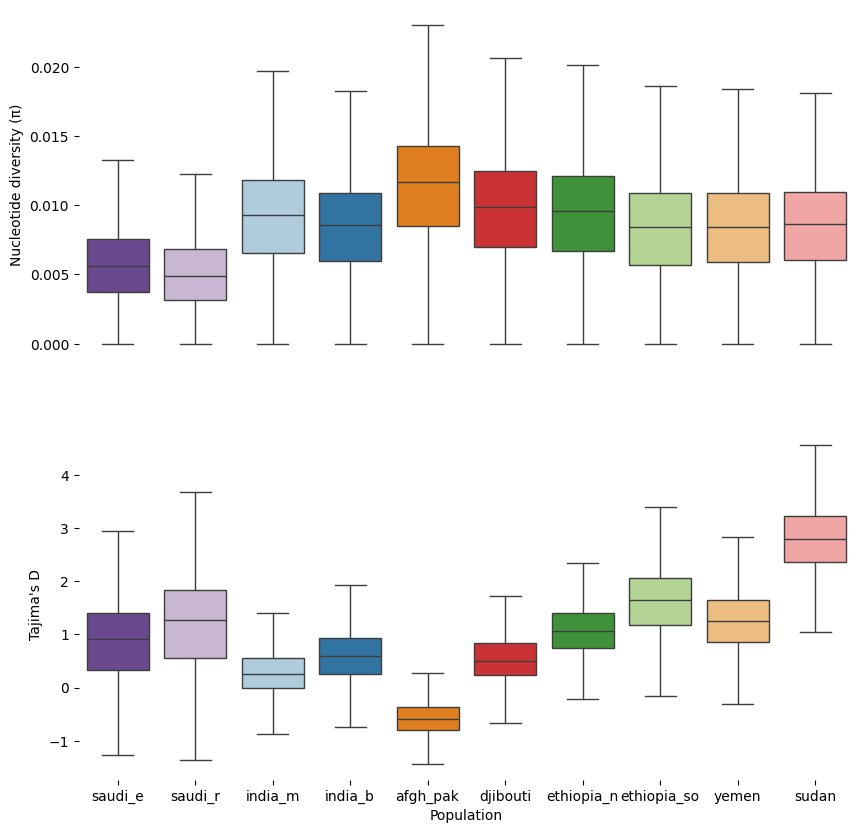

In [25]:
#Plot for pub

fig, ax =plt.subplots(2, 1, figsize=(10, 10))
# Plot the boxplots
sns.boxplot(x='analysis_pop', y='tP', hue='analysis_pop', data=pidf_long, ax=ax[0], palette=analysis_popcols, showfliers=False, order=plot_order)
ax[0].set_ylabel('Nucleotide diversity (π)')
sns.boxplot(x='analysis_pop', y='tD', hue='analysis_pop',data=tajdf_long, ax=ax[1], palette=analysis_popcols, showfliers=False, order=plot_order)
ax[1].set_ylabel("Tajima's D")

# Remove the x-axis labels from the top plot
ax[0].set_xticklabels([])
ax[0].tick_params(axis='x', which='both', bottom=False, top=False)
# Despine the plots
sns.despine(ax=ax[0])
sns.despine(ax=ax[1])

#Set x labels
ax[0].set_xlabel('')
ax[1].set_xlabel('Population')

for axis in ax:
    # Remove the surrounding box
    axis.spines['top'].set_visible(False)
    axis.spines['right'].set_visible(False)
    axis.spines['bottom'].set_visible(False)
    axis.spines['left'].set_visible(False)


plt.savefig(f'../figures/thetas.svg', format='svg')


In [ ]:
def get_ne(t, u):
    return(t / (4*u))


get_ne(0.013, 3.5e-9)